CIND 820- Big Data Analytics Project

Using Machine Learning for Prediction of Early Readmission of Diabetic Patients

Supervised by: Ceni Babaoglu

Presented by: Nehal Gamal Mohamed (501278190)


In [1]:
!pip install pandas
import sys
!{sys.executable} -m pip install -U pandas-profiling
!jupyter nbextension enable --py widgetsnbextension
!pip install matplotlib
!pip install graphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 12.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 28.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 29.0 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=af7e861983553dc87d016df39eb764a78b82273c0da1c74b5dc7e6d2590b7eb6
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
Enabling notebook extension jupyter-js-widgets/extension...
Paths used for configuration of notebook: 
    	/root/.jupyter/nbconfig/notebook.json
Paths used for configuration of notebook: 
    	
      - Validating: OK
Paths used for configuration of notebook:

In [2]:
#importing necessary libraries
import csv
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


In [3]:
#Uploading diabetic_data csv file
from google.colab import files
data = files.upload()
#Instintiating DataReader class
class DataReader:
    def read_csv(self, filename):
        df = pd.read_csv(filename)
        return df

filename = next(iter(data))
data_reader = DataReader()
df = data_reader.read_csv(filename)
#Displaying the first 10 records of the dataset
print(df.head(10))


Saving diabetic_data.csv to diabetic_data.csv
   encounter_id  patient_nbr             race  gender       age weight  \
0       2278392      8222157        Caucasian  Female    [0-10)      ?   
1        149190     55629189        Caucasian  Female   [10-20)      ?   
2         64410     86047875  AfricanAmerican  Female   [20-30)      ?   
3        500364     82442376        Caucasian    Male   [30-40)      ?   
4         16680     42519267        Caucasian    Male   [40-50)      ?   
5         35754     82637451        Caucasian    Male   [50-60)      ?   
6         55842     84259809        Caucasian    Male   [60-70)      ?   
7         63768    114882984        Caucasian    Male   [70-80)      ?   
8         12522     48330783        Caucasian  Female   [80-90)      ?   
9         15738     63555939        Caucasian  Female  [90-100)      ?   

   admission_type_id  discharge_disposition_id  admission_source_id  \
0                  6                        25                    1 

In [4]:
#Displaying variables data types
print("Dataset Information:")
print(df.info())

Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101766 entries, 0 to 101765
Data columns (total 50 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   encounter_id              101766 non-null  int64 
 1   patient_nbr               101766 non-null  int64 
 2   race                      101766 non-null  object
 3   gender                    101766 non-null  object
 4   age                       101766 non-null  object
 5   weight                    101766 non-null  object
 6   admission_type_id         101766 non-null  int64 
 7   discharge_disposition_id  101766 non-null  int64 
 8   admission_source_id       101766 non-null  int64 
 9   time_in_hospital          101766 non-null  int64 
 10  payer_code                101766 non-null  object
 11  medical_specialty         101766 non-null  object
 12  num_lab_procedures        101766 non-null  int64 
 13  num_procedures            101766 non-n

In [5]:
#Defining lists for categorical variables and numeric variables
categorical_columns = [
    'race',
    'gender',
    'age',
    'weight',
    'payer_code',
    'medical_specialty',
    'diag_1',
    'diag_2',
    'diag_3',
    'max_glu_serum',
    'A1Cresult',
    'metformin',
    'repaglinide',
    'nateglinide',
    'chlorpropamide',
    'glimepiride',
    'acetohexamide',
    'glipizide',
    'glyburide',
    'tolbutamide',
    'pioglitazone',
    'rosiglitazone',
    'acarbose',
    'miglitol',
    'troglitazone',
    'tolazamide',
    'examide',
    'citoglipton',
    'insulin',
    'glyburide-metformin',
    'glipizide-metformin',
    'glimepiride-pioglitazone',
    'metformin-rosiglitazone',
    'metformin-pioglitazone',
    'change',
    'diabetesMed',
    'readmitted'
]

numeric_columns = [
    'encounter_id',
    'patient_nbr',
    'admission_type_id',
    'discharge_disposition_id',
    'admission_source_id',
    'time_in_hospital',
    'num_lab_procedures',
    'num_procedures',
    'num_medications',
    'number_outpatient',
    'number_emergency',
    'number_inpatient',
    'number_diagnoses'
]


In [6]:
#Defining dictionaries according to the IDS_mapping file attached to the dataset
admission_type_mapping = {
    1: 'Emergency',
    2: 'Urgent',
    3: 'Elective',
    4: 'Newborn',
    5: 'Not Available',
    6: 'NULL',
    7: 'Trauma Center',
    8: 'Not Mapped'
}
df['admission_type'] = df['admission_type_id'].map(admission_type_mapping)

discharge_disposition_mapping = {
    1: 'Discharged to home',
    2: 'Discharged/transferred to another short term hospital',
    3: 'Discharged/transferred to SNF',
    4: 'Discharged/transferred to ICF',
    5: 'Discharged/transferred to another type of inpatient care institution',
    6: 'Discharged/transferred to home with home health service',
    7: 'Left AMA',
    8: 'Discharged/transferred to home under care of Home IV provider',
    9: 'Admitted as an inpatient to this hospital',
    10: 'Neonate discharged to another hospital for neonatal aftercare',
    11: 'Expired',
    12: 'Still patient or expected to return for outpatient services',
    13: 'Hospice / home',
    14: 'Hospice / medical facility',
    15: 'Discharged/transferred within this institution to Medicare approved swing bed',
    16: 'Discharged/transferred/referred another institution for outpatient services',
    17: 'Discharged/transferred/referred to this institution for outpatient services',
    18: 'NULL',
    19: 'Expired at home. Medicaid only, hospice.',
    20: 'Expired in a medical facility. Medicaid only, hospice.',
    21: 'Expired, place unknown. Medicaid only, hospice.',
    22: 'Discharged/transferred to another rehab fac including rehab units of a hospital.',
    23: 'Discharged/transferred to a long term care hospital.',
    24: 'Discharged/transferred to a nursing facility certified under Medicaid but not certified under Medicare.',
    25: 'Not Mapped',
    26: 'Unknown/Invalid',
    27: 'Discharged/transferred to a federal health care facility.',
    28: 'Discharged/transferred/referred to a psychiatric hospital of psychiatric distinct part unit of a hospital',
    29: 'Discharged/transferred to a Critical Access Hospital (CAH)',
    30: 'Discharged/transferred to another Type of Health Care Institution not Defined Elsewhere'
}
df['discharge_disposition'] = df['discharge_disposition_id'].map(discharge_disposition_mapping)

admission_source_mapping = {
    1: 'Physician Referral',
    2: 'Clinic Referral',
    3: 'HMO Referral',
    4: 'Transfer from a hospital',
    5: 'Transfer from a Skilled Nursing Facility (SNF)',
    6: 'Transfer from another health care facility',
    7: 'Emergency Room',
    8: 'Court/Law Enforcement',
    9: 'Not Available',
    10: 'Transfer from critical access hospital',
    11: 'Normal Delivery',
    12: 'Premature Delivery',
    13: 'Sick Baby',
    14: 'Extramural Birth',
    15: 'Not Available',
    17: 'NULL',
    18: 'Transfer From Another Home Health Agency',
    19: 'Readmission to Same Home Health Agency',
    20: 'Not Mapped',
    21: 'Unknown/Invalid',
    22: 'Transfer from hospital inpt/same fac reslt in a sep claim',
    23: 'Born inside this hospital',
    24: 'Born outside this hospital',
    25: 'Transfer from Ambulatory Surgery Center',
    26: 'Transfer from Hospice'
}
df['admission_source'] = df['admission_source_id'].map(admission_source_mapping)

#Displaying the first 10 records after mapping
print(df[['admission_type', 'discharge_disposition', 'admission_source']].head())



  admission_type discharge_disposition    admission_source
0           NULL            Not Mapped  Physician Referral
1      Emergency    Discharged to home      Emergency Room
2      Emergency    Discharged to home      Emergency Room
3      Emergency    Discharged to home      Emergency Room
4      Emergency    Discharged to home      Emergency Room


In [7]:
#Dataset Description
print("Dataset Description:")
print(df.describe(include='all'))

Dataset Description:
        encounter_id   patient_nbr       race  gender      age  weight  \
count   1.017660e+05  1.017660e+05     101766  101766   101766  101766   
unique           NaN           NaN          6       3       10      10   
top              NaN           NaN  Caucasian  Female  [70-80)       ?   
freq             NaN           NaN      76099   54708    26068   98569   
mean    1.652016e+08  5.433040e+07        NaN     NaN      NaN     NaN   
std     1.026403e+08  3.869636e+07        NaN     NaN      NaN     NaN   
min     1.252200e+04  1.350000e+02        NaN     NaN      NaN     NaN   
25%     8.496119e+07  2.341322e+07        NaN     NaN      NaN     NaN   
50%     1.523890e+08  4.550514e+07        NaN     NaN      NaN     NaN   
75%     2.302709e+08  8.754595e+07        NaN     NaN      NaN     NaN   
max     4.438672e+08  1.895026e+08        NaN     NaN      NaN     NaN   

        admission_type_id  discharge_disposition_id  admission_source_id  \
count       10

In [8]:
#Converted blank and "?" to NaN to represent missing values
#Checked the number of missing values in each column
df.replace({'?': np.nan, '': np.nan}, inplace=True)
missing_values = df.isna().sum()
print("Number of missing values in each column:")
print(missing_values)

Number of missing values in each column:
encounter_id                    0
patient_nbr                     0
race                         2273
gender                          0
age                             0
weight                      98569
admission_type_id               0
discharge_disposition_id        0
admission_source_id             0
time_in_hospital                0
payer_code                  40256
medical_specialty           49949
num_lab_procedures              0
num_procedures                  0
num_medications                 0
number_outpatient               0
number_emergency                0
number_inpatient                0
diag_1                         21
diag_2                        358
diag_3                       1423
number_diagnoses                0
max_glu_serum               96420
A1Cresult                   84748
metformin                       0
repaglinide                     0
nateglinide                     0
chlorpropamide                  0
glimepi

encounter_id                int64
patient_nbr                 int64
admission_type_id           int64
discharge_disposition_id    int64
admission_source_id         int64
time_in_hospital            int64
num_lab_procedures          int64
num_procedures              int64
num_medications             int64
number_outpatient           int64
number_emergency            int64
number_inpatient            int64
number_diagnoses            int64
dtype: object


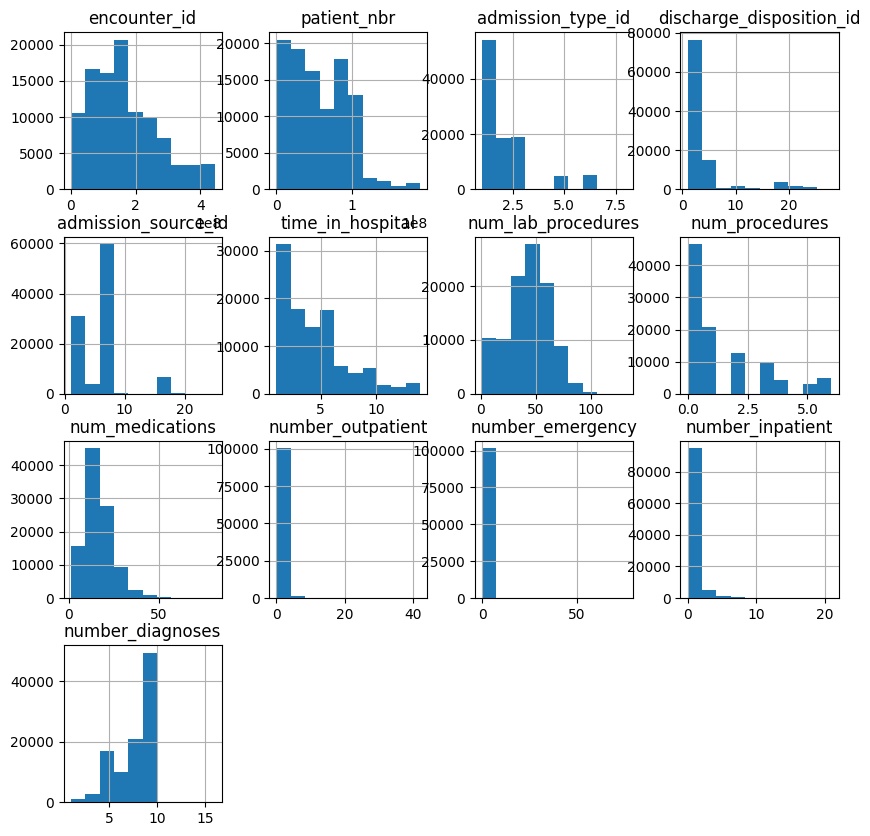

In [9]:
#Converted numeric columns to numeric types and imputed missing values with mode
for col in numeric_columns:
    df[col] = pd.to_numeric(df[col], errors='coerce')
#Displaying the numeric variables after conversion
print(df[numeric_columns].dtypes)

#Visualizing the distribution of the numeric variables
df[numeric_columns].hist(figsize=(10, 10))
plt.show()

race                        0
gender                      0
age                         0
weight                      0
payer_code                  0
medical_specialty           0
diag_1                      0
diag_2                      0
diag_3                      0
max_glu_serum               0
A1Cresult                   0
metformin                   0
repaglinide                 0
nateglinide                 0
chlorpropamide              0
glimepiride                 0
acetohexamide               0
glipizide                   0
glyburide                   0
tolbutamide                 0
pioglitazone                0
rosiglitazone               0
acarbose                    0
miglitol                    0
troglitazone                0
tolazamide                  0
examide                     0
citoglipton                 0
insulin                     0
glyburide-metformin         0
glipizide-metformin         0
glimepiride-pioglitazone    0
metformin-rosiglitazone     0
metformin-

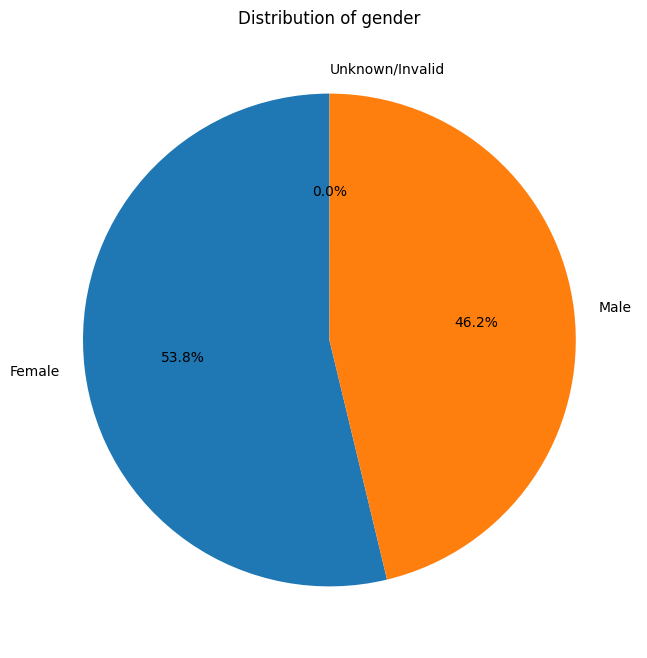

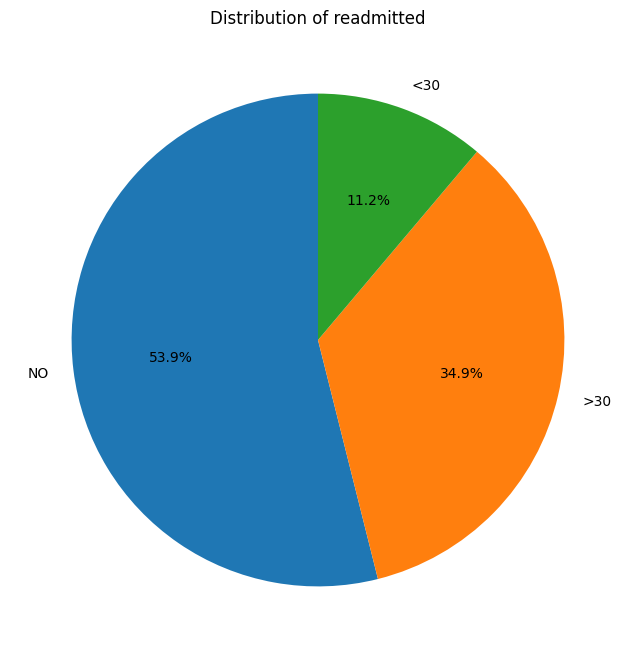

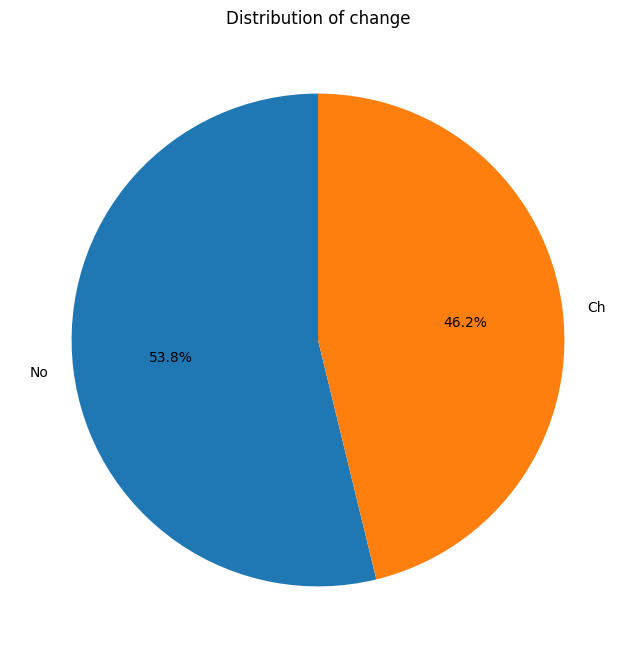

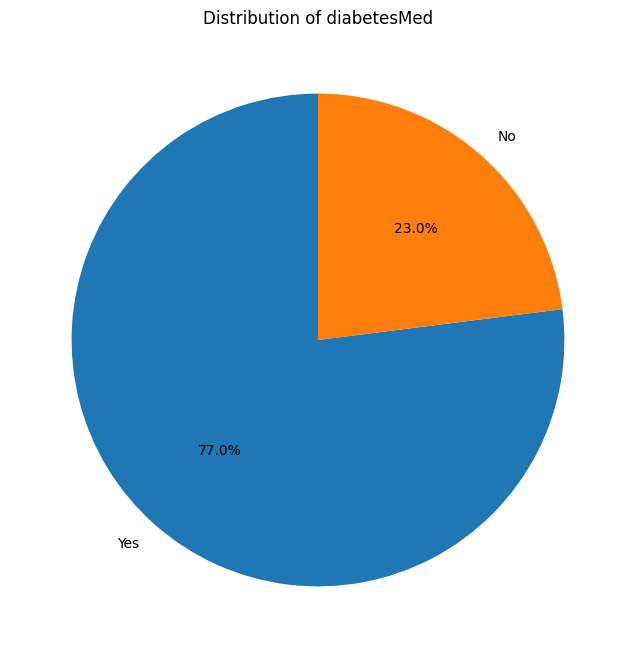

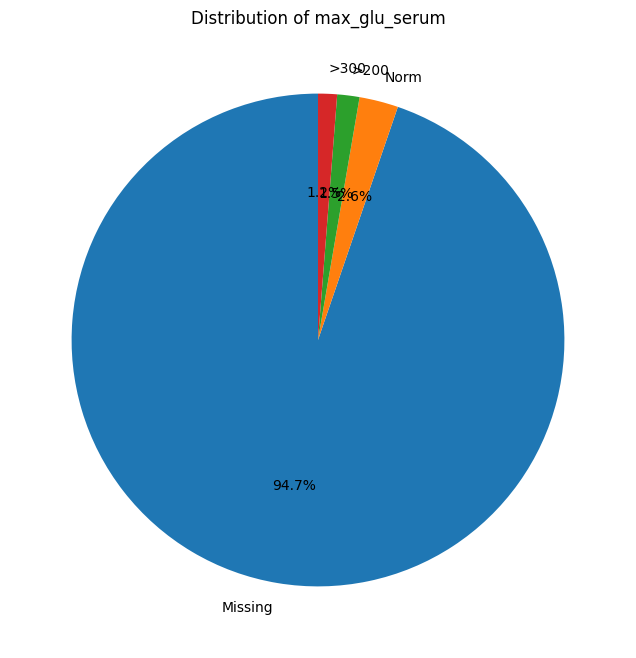

...

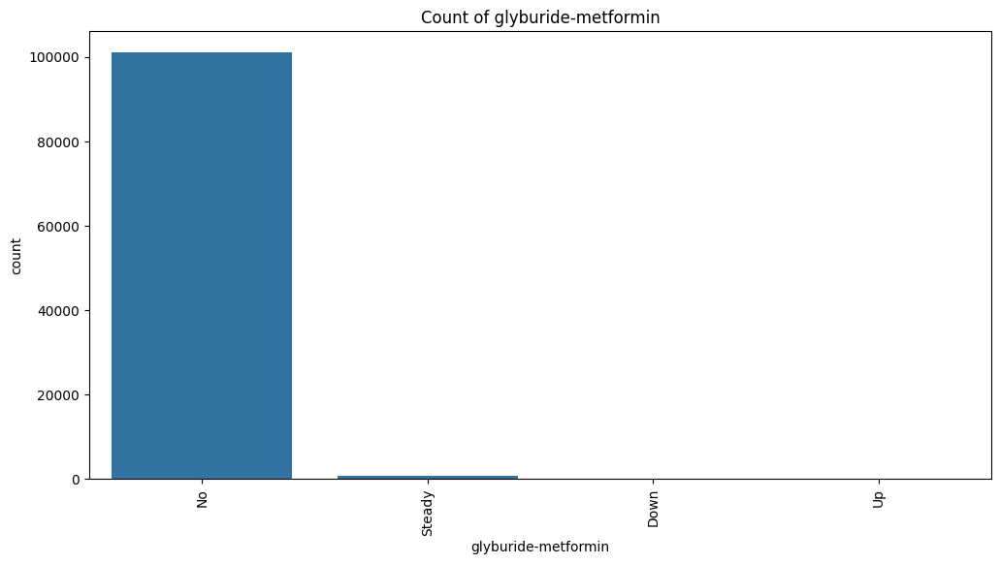

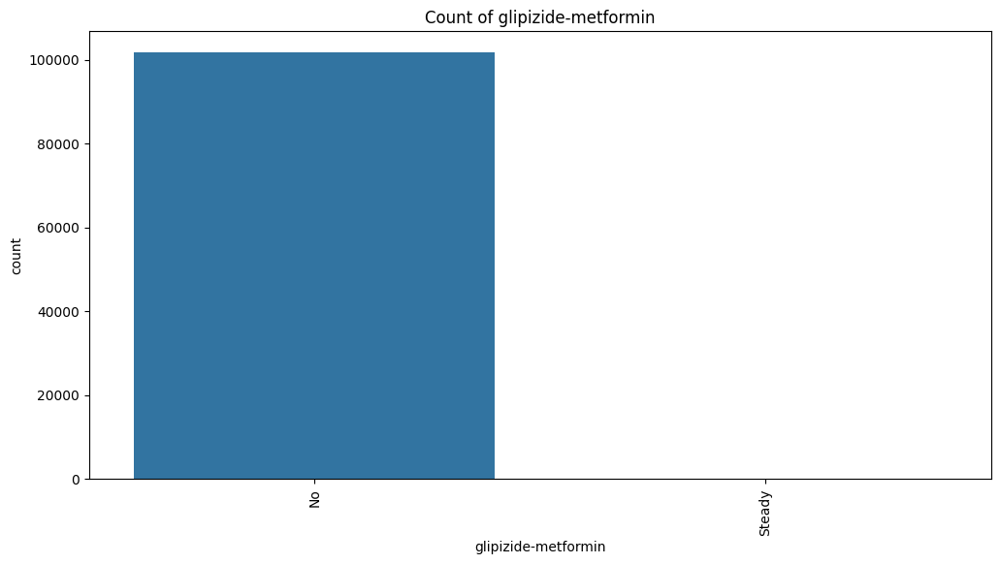

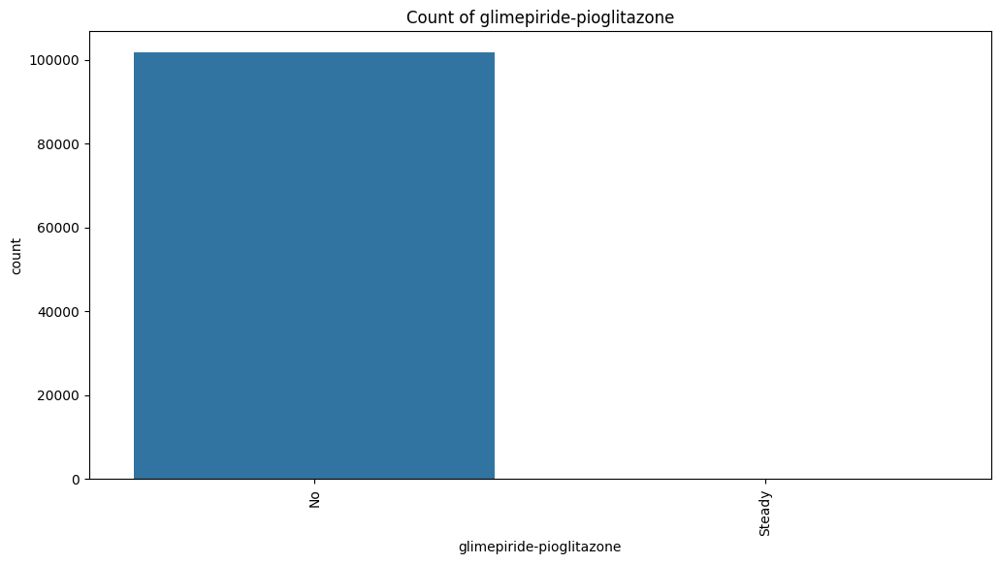

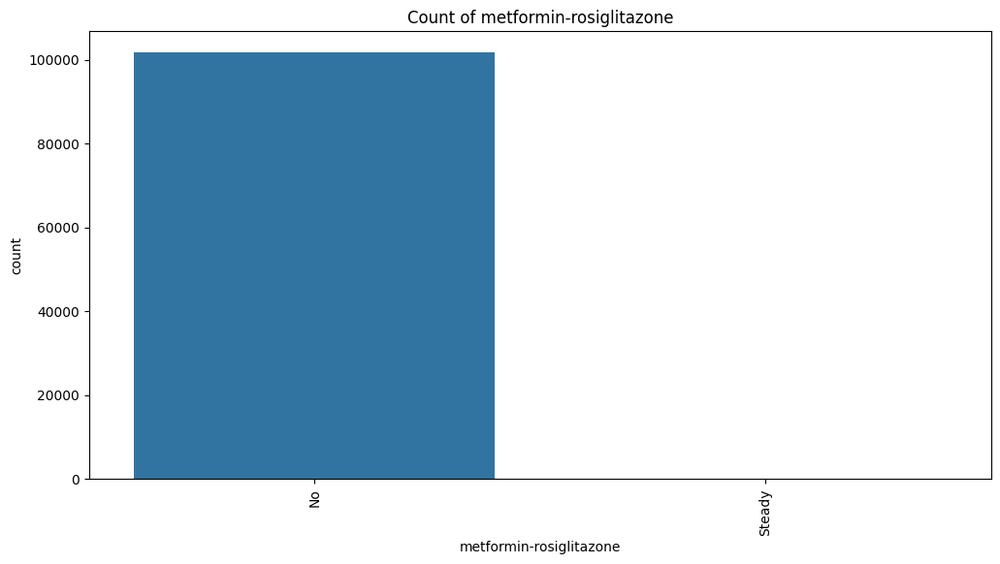

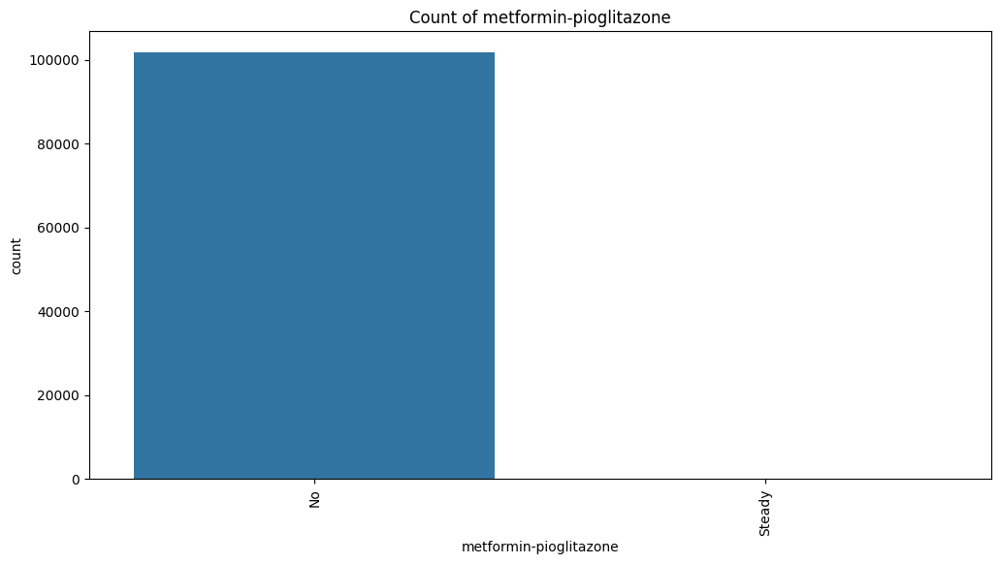

In [12]:
#Handling missing values in categorical columns by adding "Missing" as subcategory
for col in categorical_columns:
    df[col].fillna('Missing', inplace=True)
print(df[categorical_columns].isnull().sum())

#Plotting categorical variable, including missing values category
pie_chart_columns = [
    'gender', 'readmitted', 'change', 'diabetesMed',
    'max_glu_serum', 'A1Cresult', 'examide',
    'citoglipton', 'insulin', 'metformin'
]

# Plotting pie charts
for col in pie_chart_columns:
    plt.figure(figsize=(8, 8))
    df[col].value_counts().plot.pie(autopct='%1.1f%%', startangle=90)
    plt.title(f'Distribution of {col}')
    plt.ylabel('')  # Hide y-label to make it look cleaner
    plt.show()

bar_chart_columns = [
    'race', 'age', 'weight', 'payer_code', 'medical_specialty',
    'diag_1', 'diag_2', 'diag_3', 'repaglinide', 'nateglinide',
    'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide',
    'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone',
    'acarbose', 'miglitol', 'troglitazone', 'tolazamide',
    'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone',
    'metformin-rosiglitazone', 'metformin-pioglitazone'
]

# Plotting bar charts
for col in bar_chart_columns:
    plt.figure(figsize=(12, 6))
    sns.countplot(data=df, x=col)
    plt.title(f'Count of {col}')
    plt.xticks(rotation=90)
    plt.show()

In [13]:
# Check for missing values
missing_values = df.isnull().sum()
print(missing_values)

encounter_id                0
patient_nbr                 0
race                        0
gender                      0
age                         0
weight                      0
admission_type_id           0
discharge_disposition_id    0
admission_source_id         0
time_in_hospital            0
payer_code                  0
medical_specialty           0
num_lab_procedures          0
num_procedures              0
num_medications             0
number_outpatient           0
number_emergency            0
number_inpatient            0
diag_1                      0
diag_2                      0
diag_3                      0
number_diagnoses            0
max_glu_serum               0
A1Cresult                   0
metformin                   0
repaglinide                 0
nateglinide                 0
chlorpropamide              0
glimepiride                 0
acetohexamide               0
glipizide                   0
glyburide                   0
tolbutamide                 0
pioglitazo

In [14]:
#Checking for duplicate records
duplicate_records = df.duplicated().sum()
print(f"Number of duplicate records: {duplicate_records}")

Number of duplicate records: 0


In [18]:
import ydata_profiling
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="YData Profiling Report", explorative=True)
profile.to_notebook_iframe()
profile.to_file("ydata_profiling_report.html")
files.download("ydata_profiling_report.html")



Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/ydata_profiling/profile_report.py:363: UserWarning: Try running command: 'pip install --upgrade Pillow' to avoid ValueError
  warnings.warn(


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

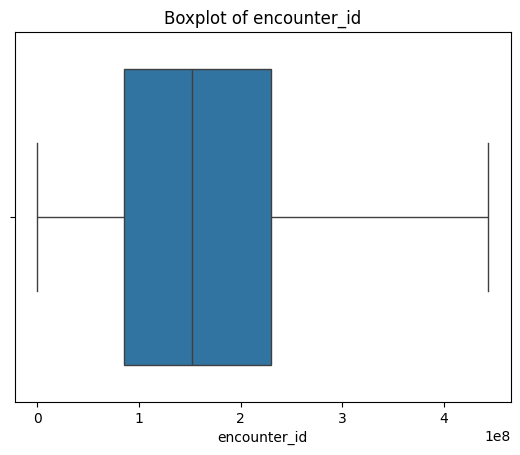

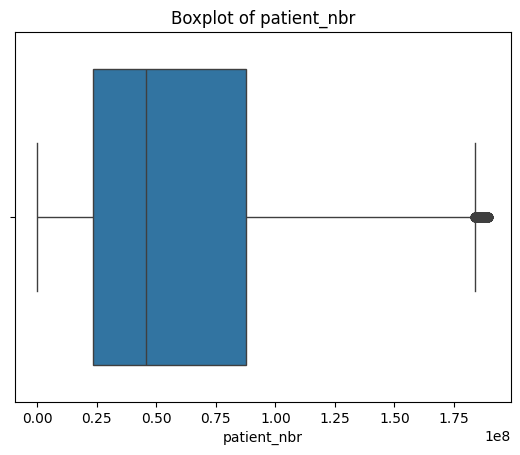

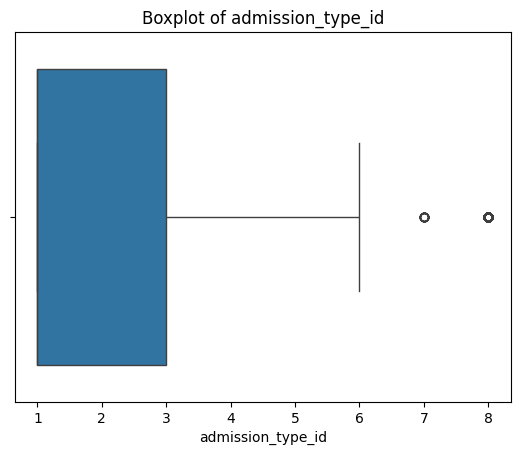

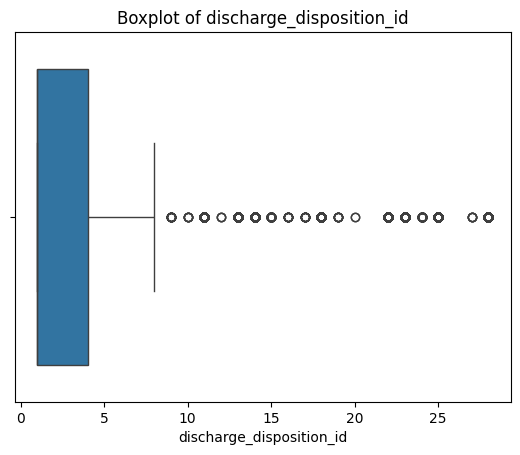

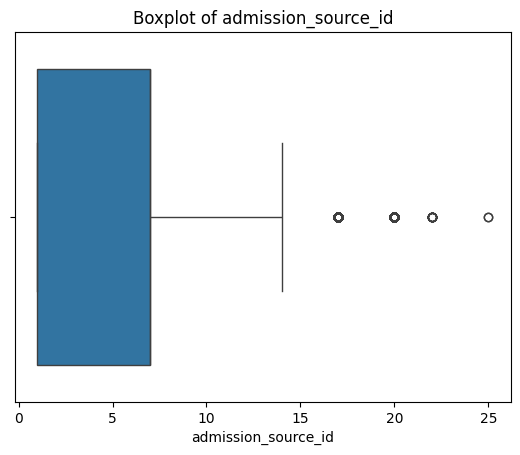

...

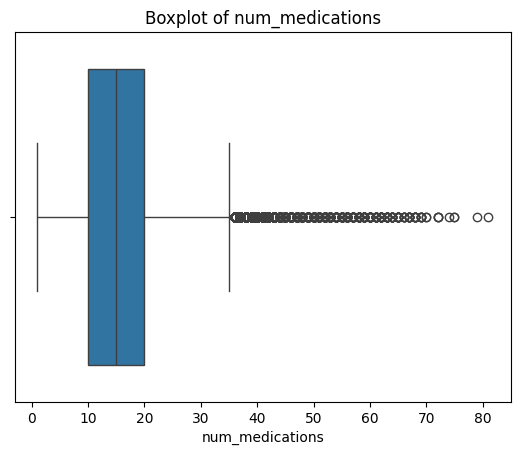

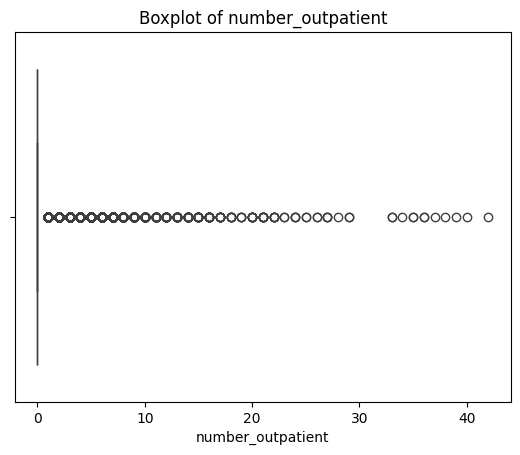

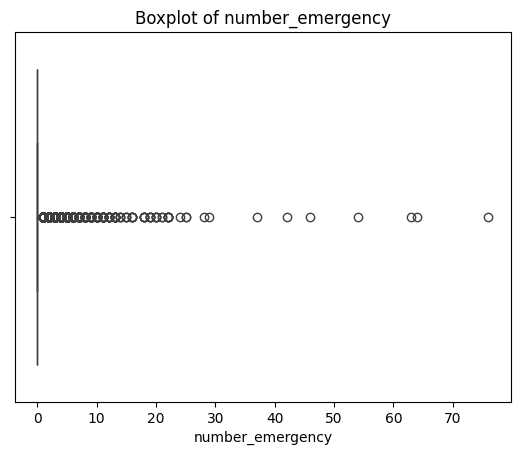

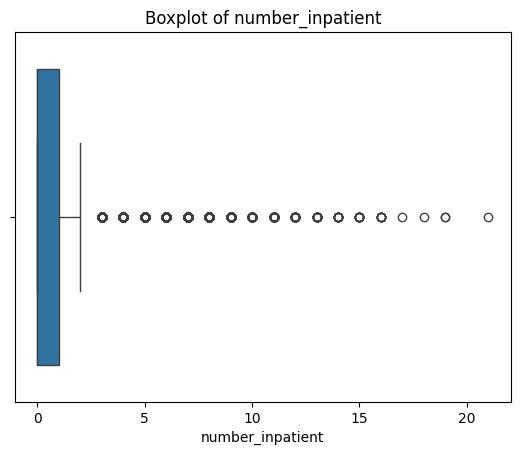

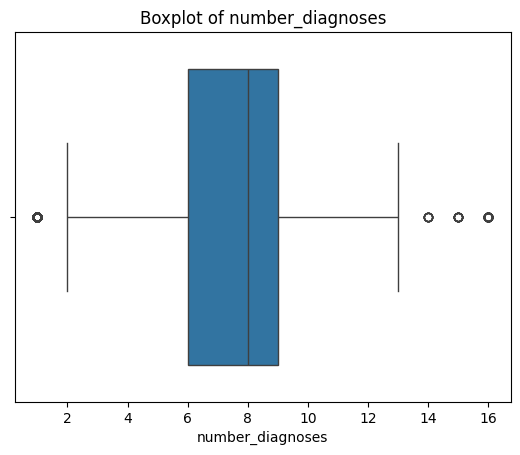

In [15]:
#Identifying outliers visually in numeric columns using boxplots
for col in numeric_columns:
    sns.boxplot(x=df[col])
    plt.title(f'Boxplot of {col}')
    plt.show()


In [16]:
#Identifying outliers in numeric columns
#Function to calculate and print outliers
def outliers(df, numeric_columns):
    outliers_count = {}

    for col in numeric_columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
        outliers_count[col] = outliers[col]

        print(f"{col}:")
        print(f"  Q1: {Q1}")
        print(f"  Q3: {Q3}")
        print(f"  IQR: {IQR}")
        print(f"  Lower Bound: {lower_bound}")
        print(f"  Upper Bound: {upper_bound}")
        print(f"  Outliers: {len(outliers)}")
        print()

    return outliers_count

#print outliers
outliers_count = outliers(df, numeric_columns)

encounter_id:
  Q1: 84961194.0
  Q3: 230270887.5
  IQR: 145309693.5
  Lower Bound: -133003346.25
  Upper Bound: 448235427.75
  Outliers: 0

patient_nbr:
  Q1: 23413221.0
  Q3: 87545949.75
  IQR: 64132728.75
  Lower Bound: -72785872.125
  Upper Bound: 183745042.875
  Outliers: 247

admission_type_id:
  Q1: 1.0
  Q3: 3.0
  IQR: 2.0
  Lower Bound: -2.0
  Upper Bound: 6.0
  Outliers: 341

discharge_disposition_id:
  Q1: 1.0
  Q3: 4.0
  IQR: 3.0
  Lower Bound: -3.5
  Upper Bound: 8.5
  Outliers: 9818

admission_source_id:
  Q1: 1.0
  Q3: 7.0
  IQR: 6.0
  Lower Bound: -8.0
  Upper Bound: 16.0
  Outliers: 6956

time_in_hospital:
  Q1: 2.0
  Q3: 6.0
  IQR: 4.0
  Lower Bound: -4.0
  Upper Bound: 12.0
  Outliers: 2252

num_lab_procedures:
  Q1: 31.0
  Q3: 57.0
  IQR: 26.0
  Lower Bound: -8.0
  Upper Bound: 96.0
  Outliers: 143

num_procedures:
  Q1: 0.0
  Q3: 2.0
  IQR: 2.0
  Lower Bound: -3.0
  Upper Bound: 5.0
  Outliers: 4954

num_medications:
  Q1: 10.0
  Q3: 20.0
  IQR: 10.0
  Lower Bound: 

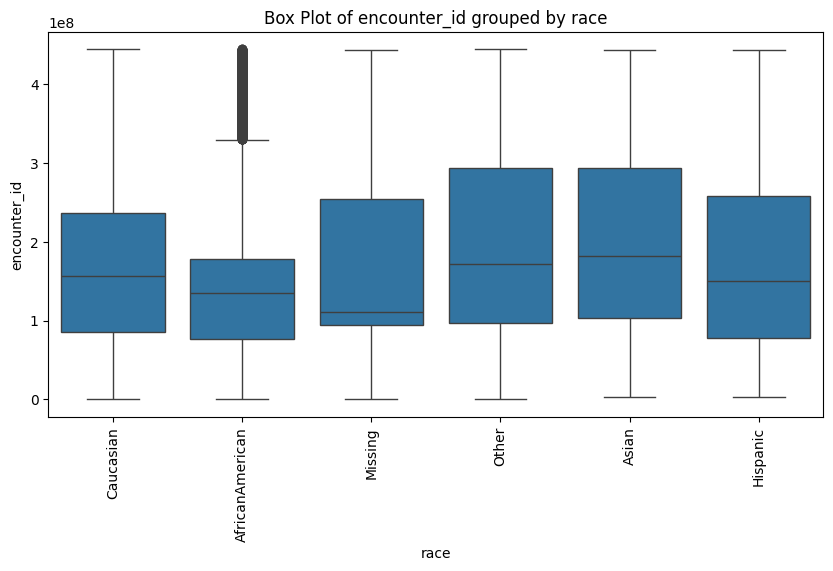

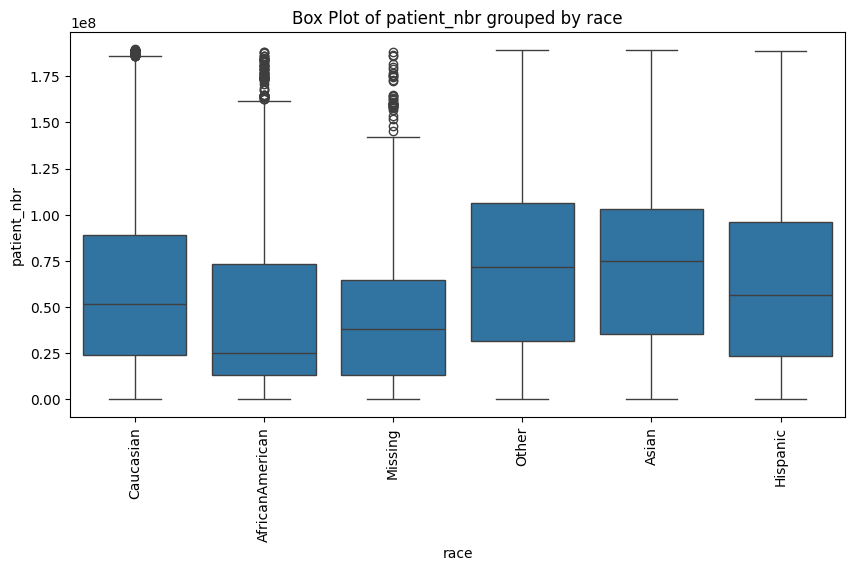

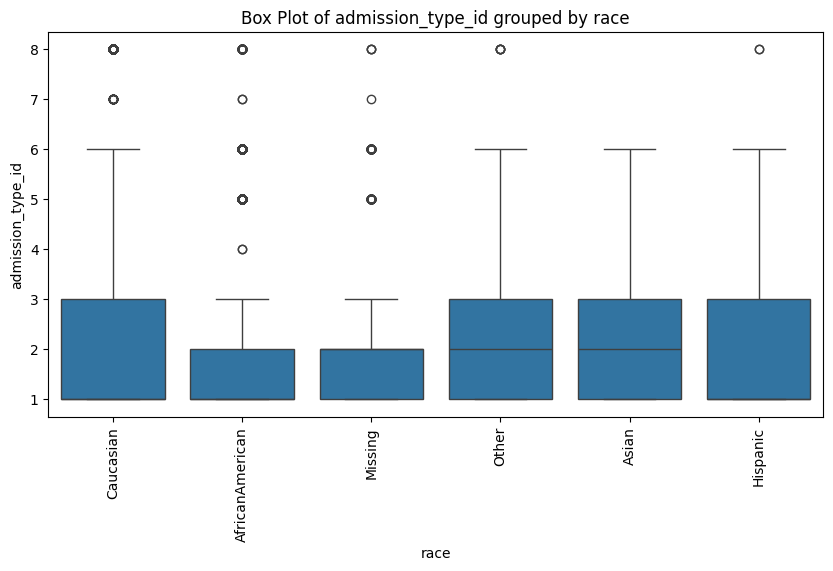

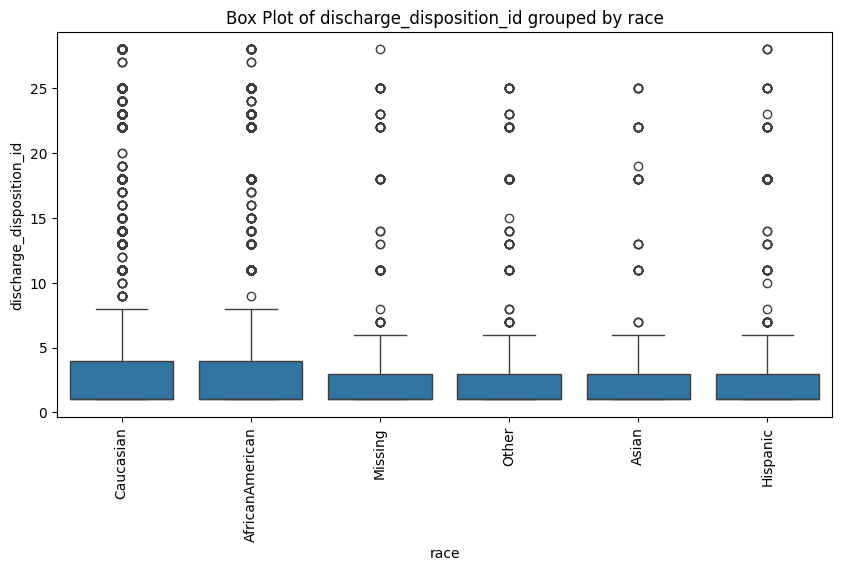

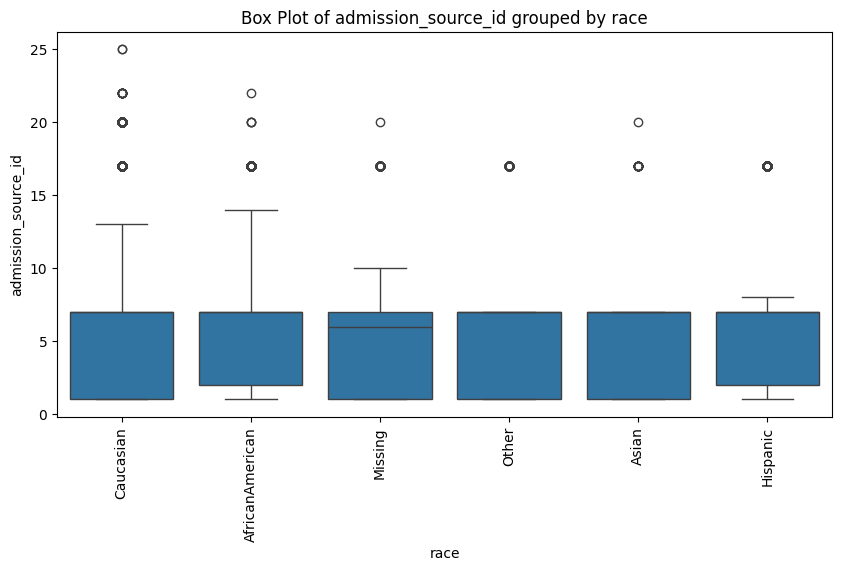

...

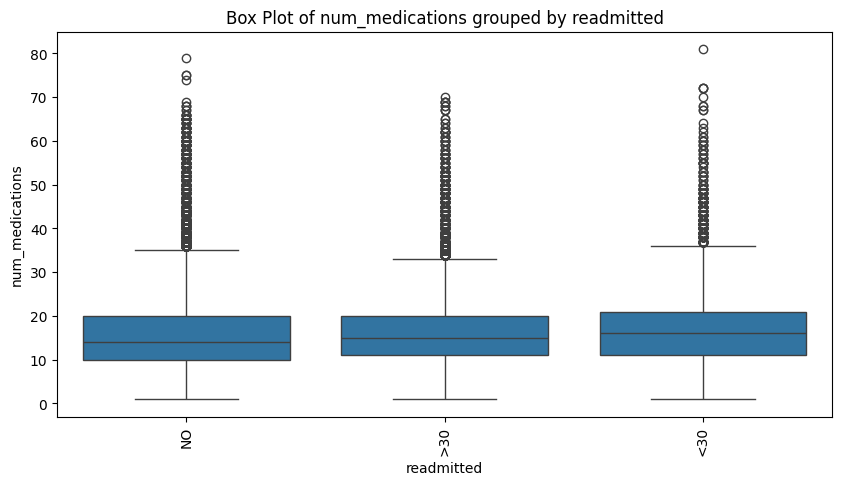

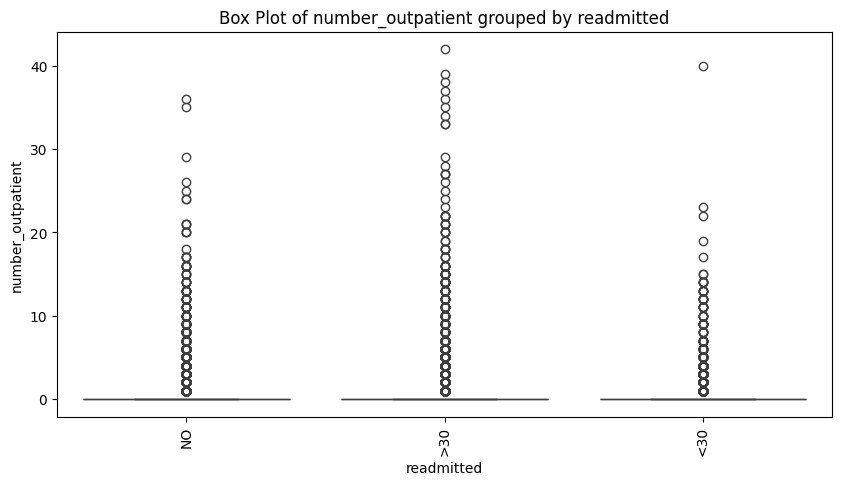

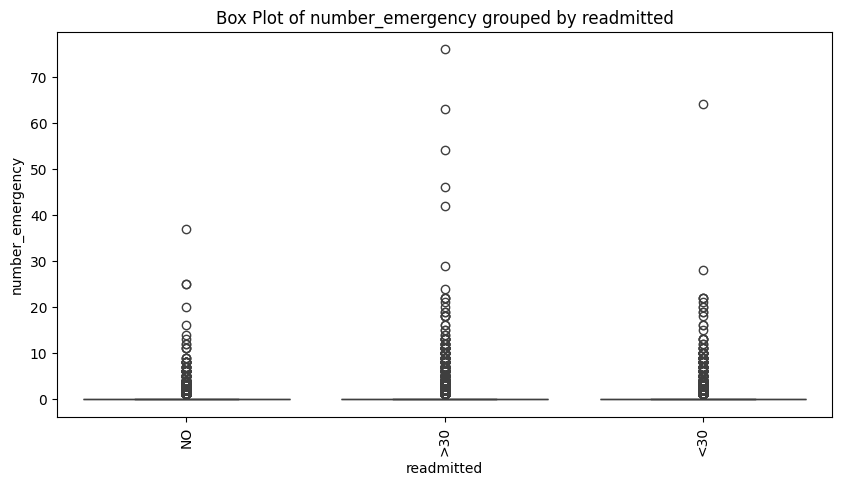

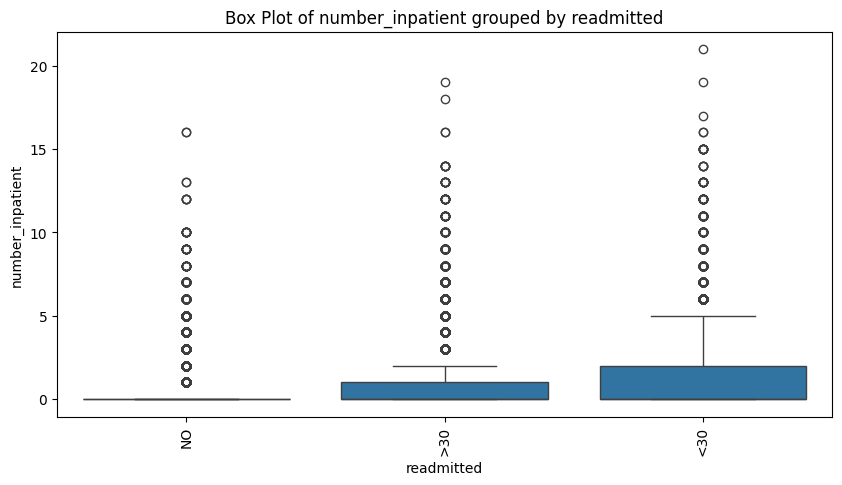

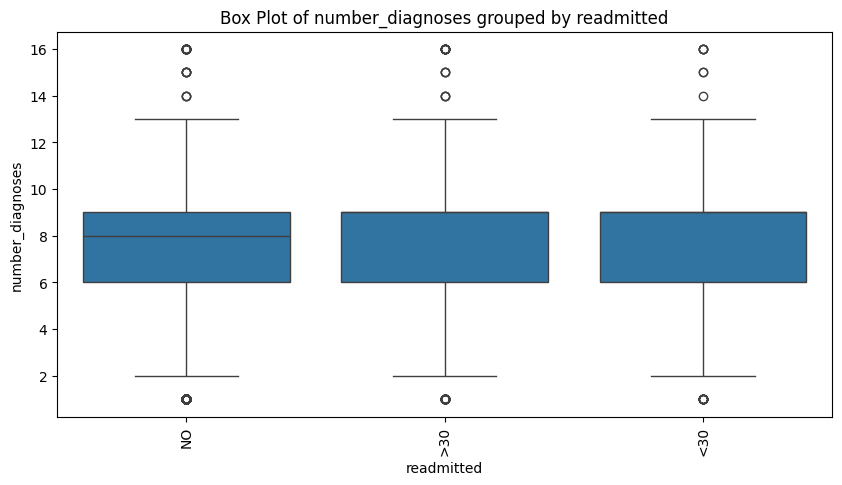

In [17]:
#Visualizing outliers through combination of categorical and numerical columns
for cat_col in categorical_columns:
    for num_col in numeric_columns:
        plt.figure(figsize=(10, 5))
        sns.boxplot(x=cat_col, y=num_col, data=df)
        plt.title(f'Box Plot of {num_col} grouped by {cat_col}')
        plt.xticks(rotation=90)
        plt.show()


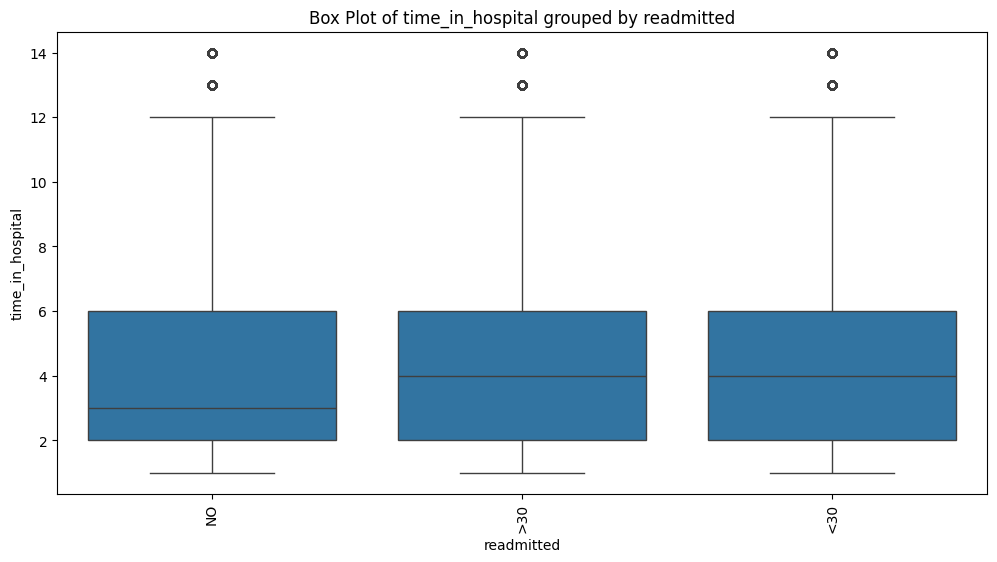

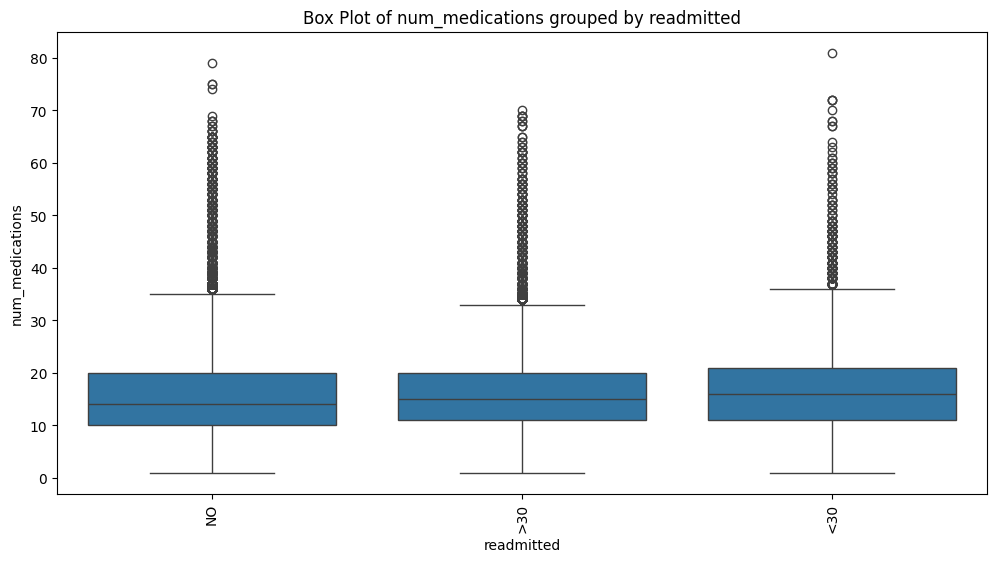

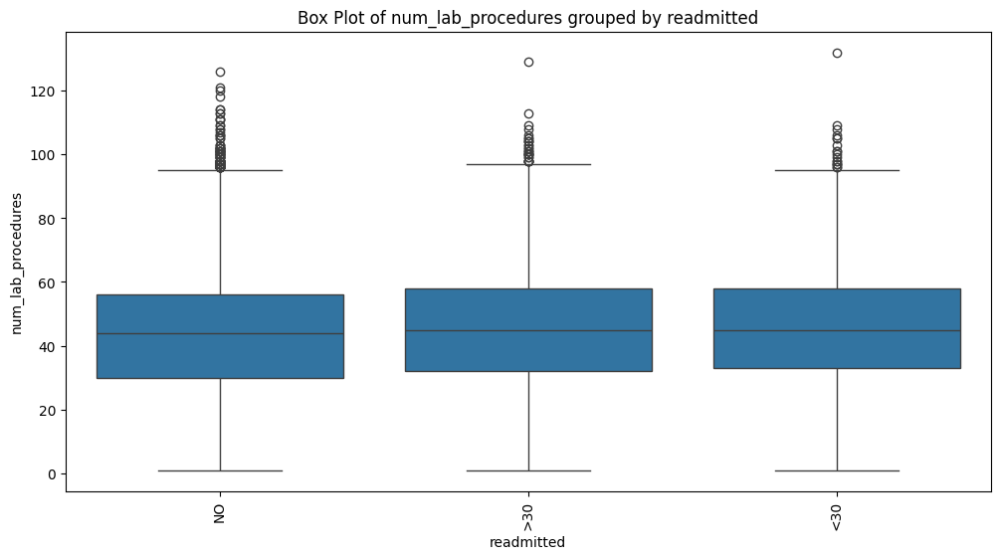

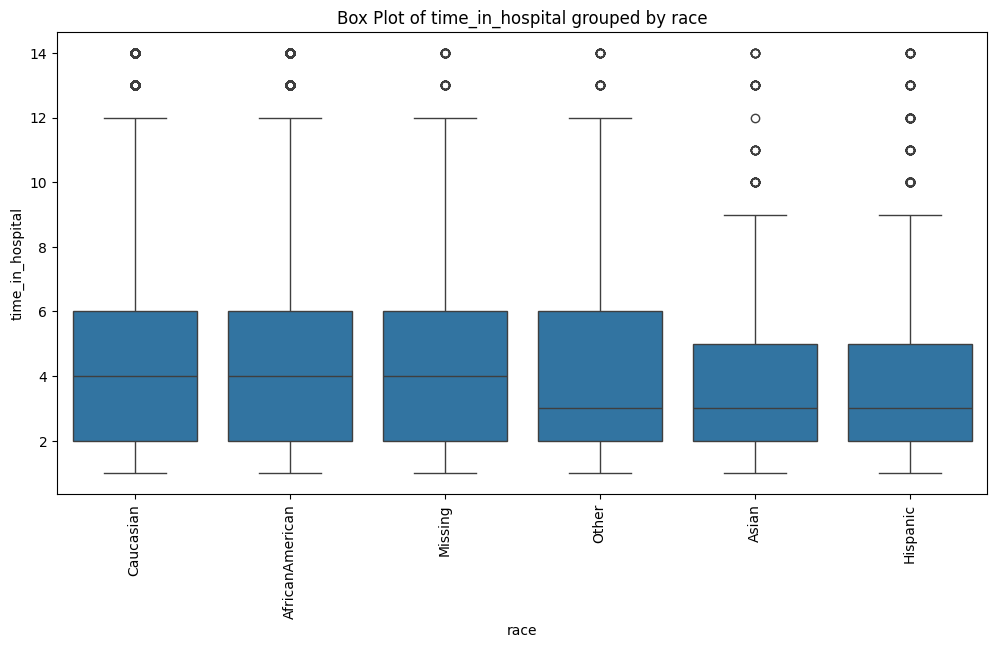

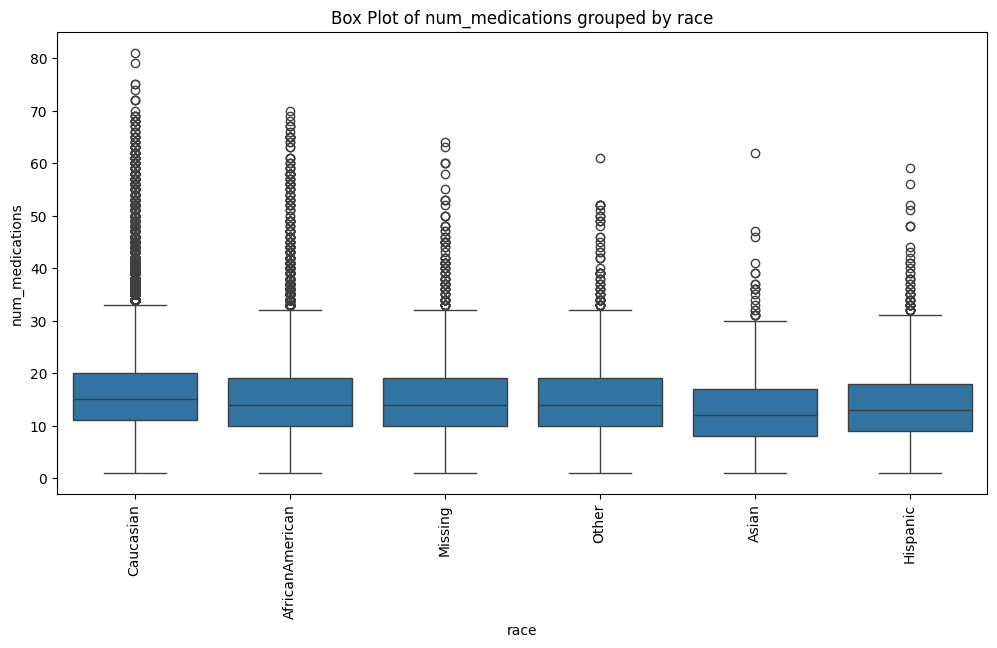

...

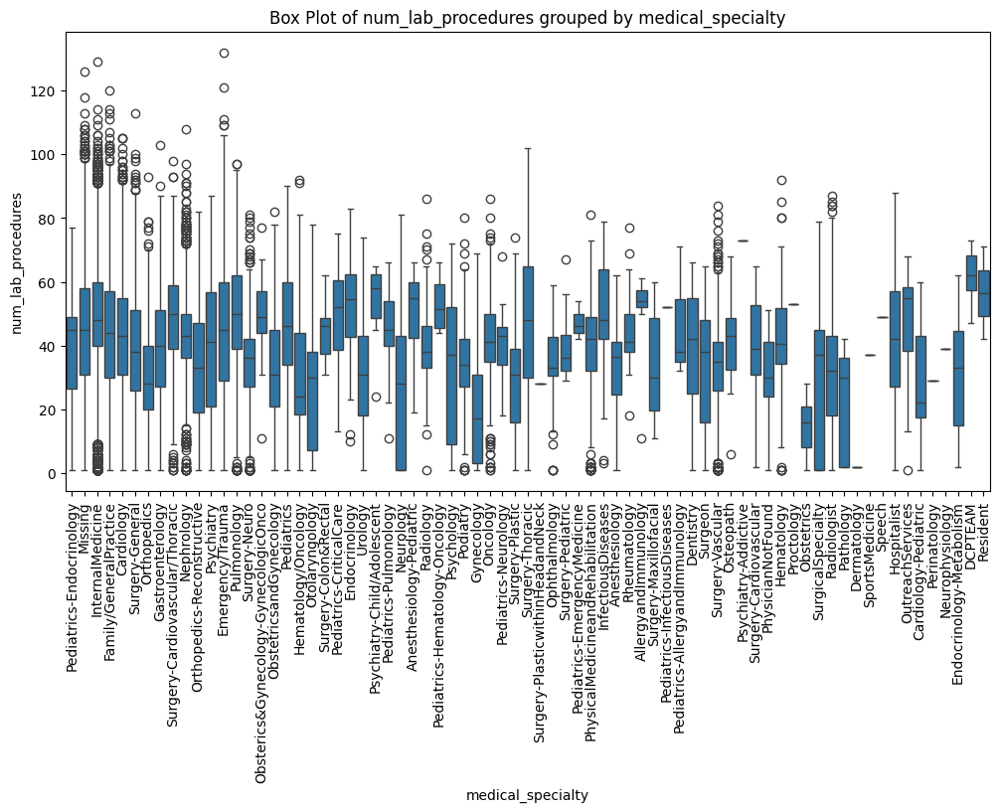

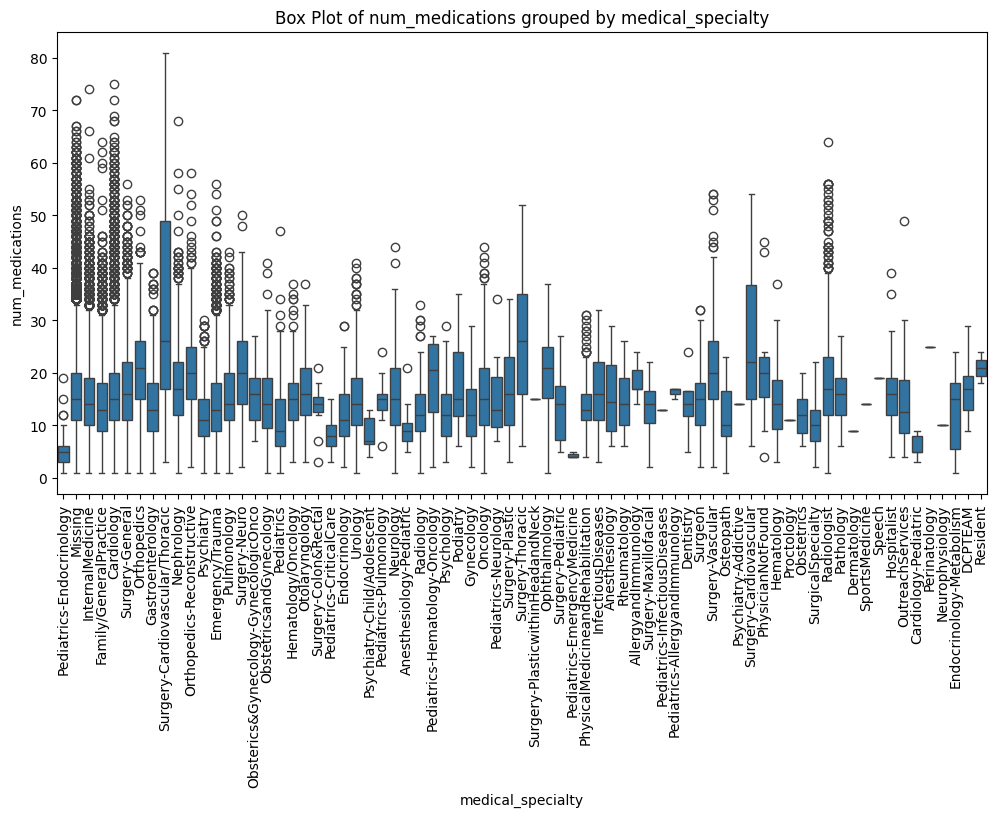

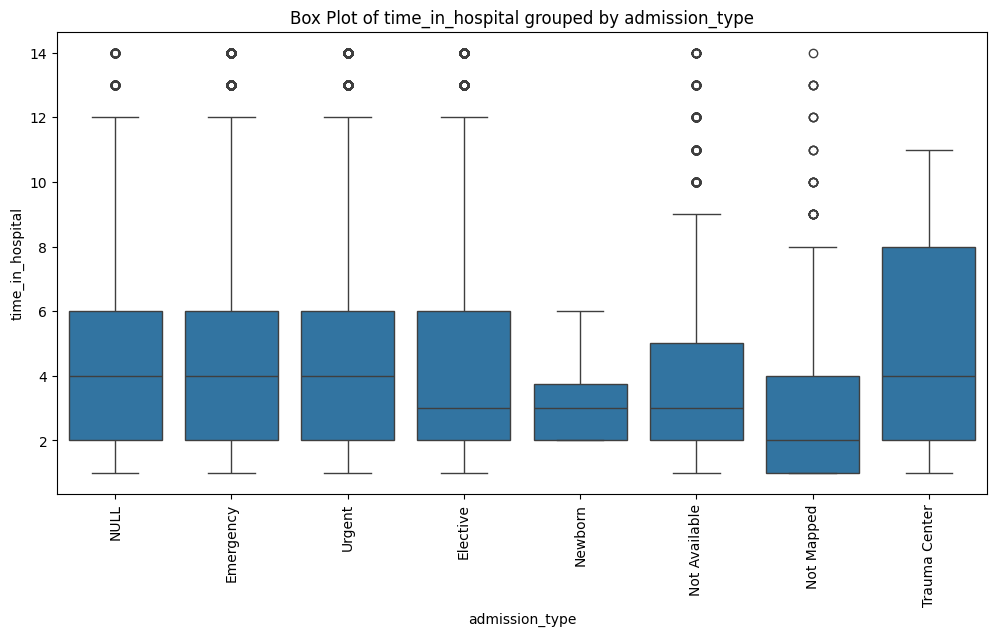

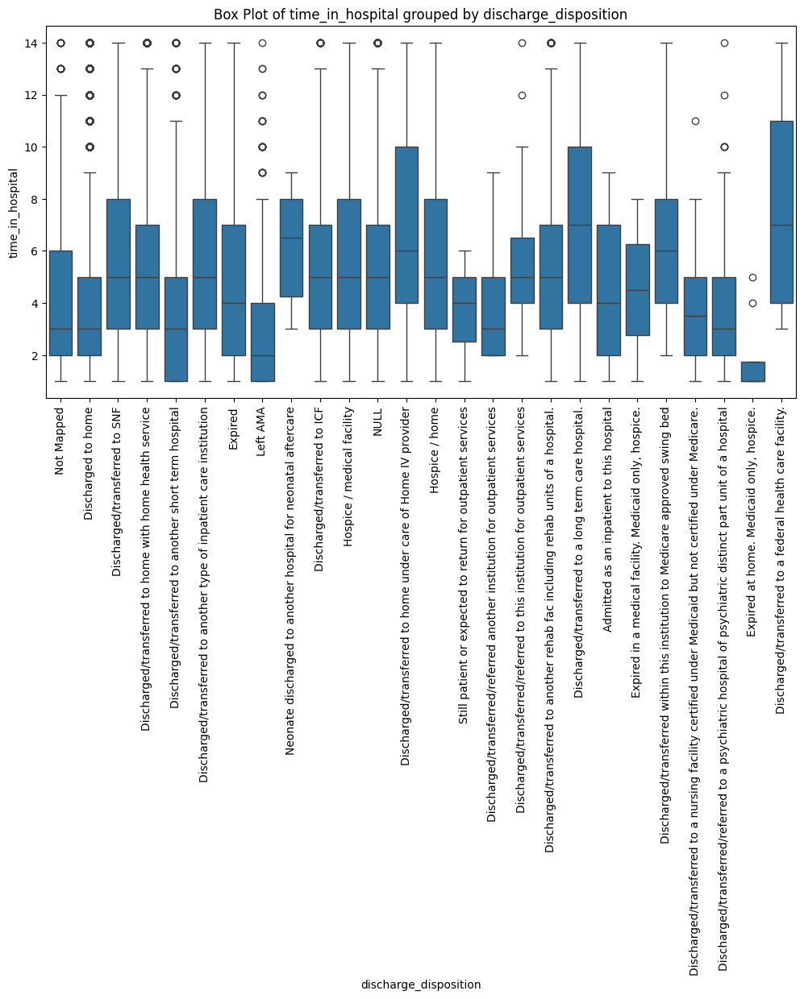

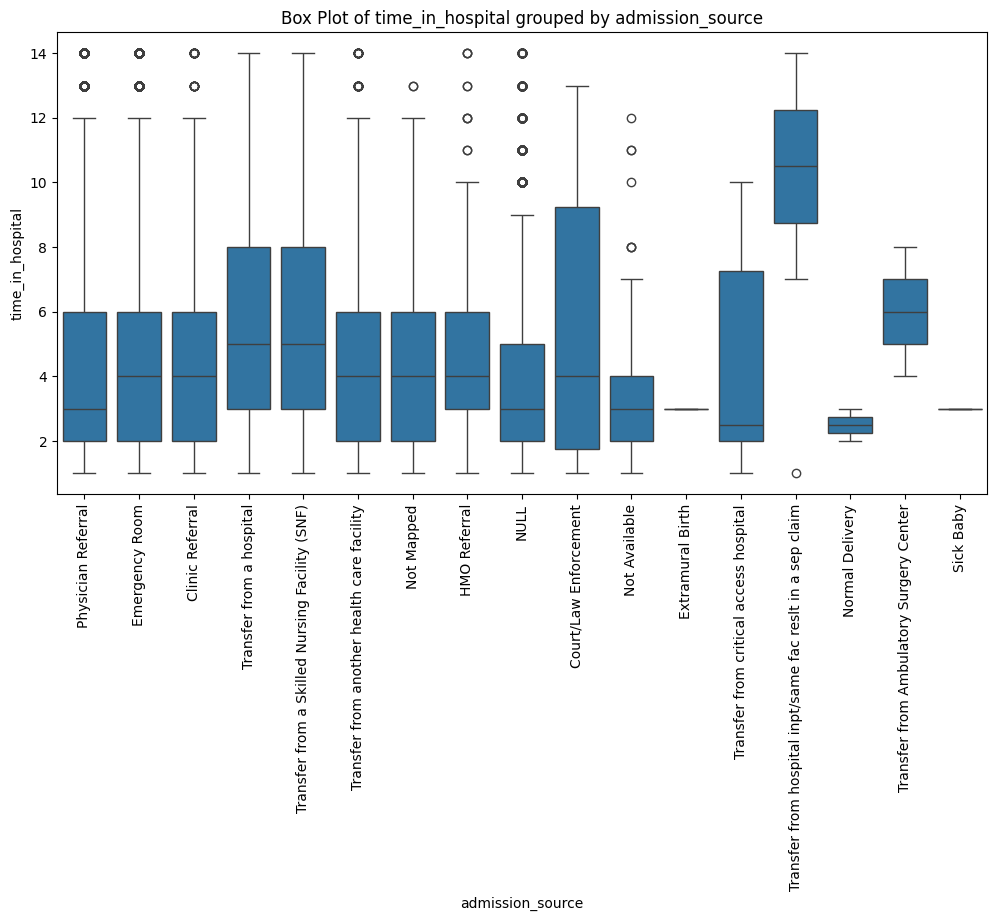

In [22]:
# Visualizing outliers for selected important combinations
important_combinations = [
    ('readmitted', 'time_in_hospital'),
    ('readmitted', 'num_medications'),
    ('readmitted', 'num_lab_procedures'),
    ('race', 'time_in_hospital'),
    ('race', 'num_medications'),
    ('gender', 'time_in_hospital'),
    ('gender', 'num_medications'),
    ('age', 'time_in_hospital'),
    ('age', 'num_medications'),
    ('medical_specialty', 'time_in_hospital'),
    ('medical_specialty', 'num_lab_procedures'),
    ('medical_specialty', 'num_medications'),
    ('admission_type', 'time_in_hospital'),
    ('discharge_disposition', 'time_in_hospital'),
    ('admission_source', 'time_in_hospital')
]

for categorical_col, numerical_col in important_combinations:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=categorical_col, y=numerical_col, data=df)
    plt.title(f'Box Plot of {numerical_col} grouped by {categorical_col}')
    plt.xticks(rotation=90)
    plt.show()
